# Mask R-CNN (Cityscapes)

**(Esegui tutto)**

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!pip install pyyaml==5.1

from IPython.display import Image, clear_output

# Cerchiamo la versione che porti il match perfetto tra le librerie
import torch
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]

!pip install detectron2 -f https://dl.fbaipublicfiles.com/detectron2/wheels/$CUDA_VERSION/torch$TORCH_VERSION/index.html

clear_output()

In [3]:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# Common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# Common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

**Decommentare modello che si vuole usare**

In [4]:
ResNet_101_FPN = "COCO-InstanceSegmentation/mask_rcnn_R_101_FPN_3x.yaml"
# ResNet_101_C4 = "COCO-InstanceSegmentation/mask_rcnn_R_101_C4_3x.yaml"
# ResNet_101_DC5 = "COCO-InstanceSegmentation/mask_rcnn_R_101_DC5_3x.yaml"
# Resnet_50_FPN = "COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_1x.yaml"
# Resnet_50_C4 = "COCO-InstanceSegmentation/mask_rcnn_R_50_C4_1x.yaml"
# Resnet_50_DC5 = "COCO-InstanceSegmentation/mask_rcnn_R_50_DC5_1x.yaml"

# ecc ecc 


In [5]:
!python -m pip install cityscapesscripts

clear_output()

In [6]:
import functools
import json
import logging
import multiprocessing as mp
import numpy as np
import os
from itertools import chain
import pycocotools.mask as mask_util
from PIL import Image

from detectron2.structures import BoxMode
from detectron2.utils.comm import get_world_size
from detectron2.utils.file_io import PathManager
from detectron2.utils.logger import setup_logger

from cityscapesscripts.helpers.labels import labels
from cityscapesscripts.helpers.labels import id2label, name2label

try:
    import cv2
except ImportError:
    # OpenCV is an optional dependency at the moment
    pass


logger = logging.getLogger(__name__)


def _get_cityscapes_files(image_dir, gt_dir):
    files = []
    # scan through the directory
    cities = PathManager.ls(image_dir)
    logger.info(f"{len(cities)} cities found in '{image_dir}'.")
    for city in cities:
        city_img_dir = os.path.join(image_dir, city)
        city_gt_dir = os.path.join(gt_dir, city)
        for basename in PathManager.ls(city_img_dir):
            image_file = os.path.join(city_img_dir, basename)

            suffix = "leftImg8bit.png"
            assert basename.endswith(suffix), basename
            basename = basename[: -len(suffix)]

            instance_file = os.path.join(city_gt_dir, basename + "gtFine_instanceIds.png")
            label_file = os.path.join(city_gt_dir, basename + "gtFine_labelIds.png")
            json_file = os.path.join(city_gt_dir, basename + "gtFine_polygons.json")

            files.append((image_file, instance_file, label_file, json_file))
    assert len(files), "No images found in {}".format(image_dir)
    for f in files[0]:
        assert PathManager.isfile(f), f
    return files


def load_cityscapes_instances(image_dir, gt_dir, from_json=True, to_polygons=True):
    """
    Args:
        image_dir (str): path to the raw dataset. e.g., "~/cityscapes/leftImg8bit/train".
        gt_dir (str): path to the raw annotations. e.g., "~/cityscapes/gtFine/train".
        from_json (bool): whether to read annotations from the raw json file or the png files.
        to_polygons (bool): whether to represent the segmentation as polygons
            (COCO's format) instead of masks (cityscapes's format).

    Returns:
        list[dict]: a list of dicts in Detectron2 standard format. (See
        `Using Custom Datasets </tutorials/datasets.html>`_ )
    """
    if from_json:
        assert to_polygons, (
            "Cityscapes's json annotations are in polygon format. "
            "Converting to mask format is not supported now."
        )
    files = _get_cityscapes_files(image_dir, gt_dir)

    logger.info("Preprocessing cityscapes annotations ...")
    # This is still not fast: all workers will execute duplicate works and will
    # take up to 10m on a 8GPU server.
    pool = mp.Pool(processes=max(mp.cpu_count() // get_world_size() // 2, 4))

    ret = pool.map(
        functools.partial(_cityscapes_files_to_dict, from_json=from_json, to_polygons=to_polygons),
        files,
    )
    logger.info("Loaded {} images from {}".format(len(ret), image_dir))

    # Map cityscape ids to contiguous ids
    from cityscapesscripts.helpers.labels import labels

    labels = [l for l in labels if l.hasInstances and not l.ignoreInEval]
    dataset_id_to_contiguous_id = {l.id: idx for idx, l in enumerate(labels)}
    for dict_per_image in ret:
        for anno in dict_per_image["annotations"]:
            anno["category_id"] = dataset_id_to_contiguous_id[anno["category_id"]]
    return ret


def load_cityscapes_semantic(image_dir, gt_dir):
    """
    Args:
        image_dir (str): path to the raw dataset. e.g., "~/cityscapes/leftImg8bit/train".
        gt_dir (str): path to the raw annotations. e.g., "~/cityscapes/gtFine/train".

    Returns:
        list[dict]: a list of dict, each has "file_name" and
            "sem_seg_file_name".
    """
    ret = []
    # gt_dir is small and contain many small files. make sense to fetch to local first
    gt_dir = PathManager.get_local_path(gt_dir)
    for image_file, _, label_file, json_file in _get_cityscapes_files(image_dir, gt_dir):
        label_file = label_file.replace("labelIds", "labelTrainIds")

        with PathManager.open(json_file, "r") as f:
            jsonobj = json.load(f)
        ret.append(
            {
                "file_name": image_file,
                "sem_seg_file_name": label_file,
                "height": jsonobj["imgHeight"],
                "width": jsonobj["imgWidth"],
            }
        )
    assert len(ret), f"No images found in {image_dir}!"
    assert PathManager.isfile(
        ret[0]["sem_seg_file_name"]
    ), "Please generate labelTrainIds.png with cityscapesscripts/preparation/createTrainIdLabelImgs.py"  # noqa
    return ret


def _cityscapes_files_to_dict(files, from_json, to_polygons):
    """
    Parse cityscapes annotation files to a instance segmentation dataset dict.

    Args:
        files (tuple): consists of (image_file, instance_id_file, label_id_file, json_file)
        from_json (bool): whether to read annotations from the raw json file or the png files.
        to_polygons (bool): whether to represent the segmentation as polygons
            (COCO's format) instead of masks (cityscapes's format).

    Returns:
        A dict in Detectron2 Dataset format.
    """
    from cityscapesscripts.helpers.labels import id2label, name2label

    image_file, instance_id_file, _, json_file = files

    annos = []

    if from_json:
        from shapely.geometry import MultiPolygon, Polygon

        with PathManager.open(json_file, "r") as f:
            jsonobj = json.load(f)
        ret = {
            "file_name": image_file,
            "image_id": os.path.basename(image_file),
            "height": jsonobj["imgHeight"],
            "width": jsonobj["imgWidth"],
        }

        # `polygons_union` contains the union of all valid polygons.
        polygons_union = Polygon()

        # CityscapesScripts draw the polygons in sequential order
        # and each polygon *overwrites* existing ones. See
        # (https://github.com/mcordts/cityscapesScripts/blob/master/cityscapesscripts/preparation/json2instanceImg.py) # noqa
        # We use reverse order, and each polygon *avoids* early ones.
        # This will resolve the ploygon overlaps in the same way as CityscapesScripts.
        for obj in jsonobj["objects"][::-1]:
            if "deleted" in obj:  # cityscapes data format specific
                continue
            label_name = obj["label"]

            try:
                label = name2label[label_name]
            except KeyError:
                if label_name.endswith("group"):  # crowd area
                    label = name2label[label_name[: -len("group")]]
                else:
                    raise
            if label.id < 0:  # cityscapes data format
                continue

            # Cityscapes's raw annotations uses integer coordinates
            # Therefore +0.5 here
            poly_coord = np.asarray(obj["polygon"], dtype="f4") + 0.5
            # CityscapesScript uses PIL.ImageDraw.polygon to rasterize
            # polygons for evaluation. This function operates in integer space
            # and draws each pixel whose center falls into the polygon.
            # Therefore it draws a polygon which is 0.5 "fatter" in expectation.
            # We therefore dilate the input polygon by 0.5 as our input.
            poly = Polygon(poly_coord).buffer(0.5, resolution=4)

            if not label.hasInstances or label.ignoreInEval:
                # even if we won't store the polygon it still contributes to overlaps resolution
                polygons_union = polygons_union.union(poly)
                continue

            # Take non-overlapping part of the polygon
            poly_wo_overlaps = poly.difference(polygons_union)
            if poly_wo_overlaps.is_empty:
                continue
            polygons_union = polygons_union.union(poly)

            anno = {}
            anno["iscrowd"] = label_name.endswith("group")
            anno["category_id"] = label.id

            if isinstance(poly_wo_overlaps, Polygon):
                poly_list = [poly_wo_overlaps]
            elif isinstance(poly_wo_overlaps, MultiPolygon):
                poly_list = poly_wo_overlaps.geoms
            else:
                raise NotImplementedError("Unknown geometric structure {}".format(poly_wo_overlaps))

            poly_coord = []
            for poly_el in poly_list:
                # COCO API can work only with exterior boundaries now, hence we store only them.
                # TODO: store both exterior and interior boundaries once other parts of the
                # codebase support holes in polygons.
                poly_coord.append(list(chain(*poly_el.exterior.coords)))
            anno["segmentation"] = poly_coord
            (xmin, ymin, xmax, ymax) = poly_wo_overlaps.bounds

            anno["bbox"] = (xmin, ymin, xmax, ymax)
            anno["bbox_mode"] = BoxMode.XYXY_ABS

            annos.append(anno)
    else:
        # See also the official annotation parsing scripts at
        # https://github.com/mcordts/cityscapesScripts/blob/master/cityscapesscripts/evaluation/instances2dict.py  # noqa
        with PathManager.open(instance_id_file, "rb") as f:
            inst_image = np.asarray(Image.open(f), order="F")
        # ids < 24 are stuff labels (filtering them first is about 5% faster)
        flattened_ids = np.unique(inst_image[inst_image >= 24])

        ret = {
            "file_name": image_file,
            "image_id": os.path.basename(image_file),
            "height": inst_image.shape[0],
            "width": inst_image.shape[1],
        }

        for instance_id in flattened_ids:
            # For non-crowd annotations, instance_id // 1000 is the label_id
            # Crowd annotations have <1000 instance ids
            label_id = instance_id // 1000 if instance_id >= 1000 else instance_id
            label = id2label[label_id]
            if not label.hasInstances or label.ignoreInEval:
                continue

            anno = {}
            anno["iscrowd"] = instance_id < 1000
            anno["category_id"] = label.id

            mask = np.asarray(inst_image == instance_id, dtype=np.uint8, order="F")

            inds = np.nonzero(mask)
            ymin, ymax = inds[0].min(), inds[0].max()
            xmin, xmax = inds[1].min(), inds[1].max()
            anno["bbox"] = (xmin, ymin, xmax, ymax)
            if xmax <= xmin or ymax <= ymin:
                continue
            anno["bbox_mode"] = BoxMode.XYXY_ABS
            if to_polygons:
                # This conversion comes from D4809743 and D5171122,
                # when Mask-RCNN was first developed.
                contours = cv2.findContours(mask.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_NONE)[
                    -2
                ]
                polygons = [c.reshape(-1).tolist() for c in contours if len(c) >= 3]
                # opencv's can produce invalid polygons
                if len(polygons) == 0:
                    continue
                anno["segmentation"] = polygons
            else:
                anno["segmentation"] = mask_util.encode(mask[:, :, None])[0]
            annos.append(anno)
    ret["annotations"] = annos
    return ret

In [7]:
cityscapes_classes = [k.name for k in labels if k.hasInstances and not k.ignoreInEval]

image_dir = "/content/drive/MyDrive/datasets/cityscapes/leftImg8bit/"
gt_dir = "/content/drive/MyDrive/datasets/cityscapes/gtFine/"

for d in ["train"]:
  DatasetCatalog.register("cityscapes_" + d, lambda x=image_dir+d, y=gt_dir+d: load_cityscapes_instances(x, y))
  MetadataCatalog.get("cityscapes_" + d).set(thing_classes=cityscapes_classes, evaluator_type="coco")

for d in ["val"]:
  DatasetCatalog.register("cityscapes_" + d, lambda x=image_dir+d, y=gt_dir+d: load_cityscapes_instances(x, y))
  MetadataCatalog.get("cityscapes_" + d).set(thing_classes=cityscapes_classes, evaluator_type="coco")

for d in ["test"]:
  DatasetCatalog.register("cityscapes_" + d, lambda x=image_dir+d, y=gt_dir+d: load_cityscapes_instances(x, y))
  MetadataCatalog.get("cityscapes_" + d).set(thing_classes=cityscapes_classes, evaluator_type="coco")


**Cambiare qui i parametri**

In [8]:
from detectron2.engine import DefaultTrainer

# CFG OBBLIGATORIE
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file(ResNet_101_FPN))
cfg.DATASETS.TRAIN = ("cityscapes_train",)
cfg.DATASETS.TEST = ()
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url(ResNet_101_FPN)


#CFG SETTABILI
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128 # default 512 - numero di img per calcolare la loss ad ogni step
cfg.SOLVER.IMS_PER_BATCH = 1 # default 16 (# Number of images per batch across all machines. This is also the number
                                          # of training images per step (i.e. per iteration). If we use 16 GPUs
                                          # and IMS_PER_BATCH = 32, each GPU will see 2 images per batch.)
cfg.SOLVER.BASE_LR = 0.001 
cfg.SOLVER.MAX_ITER = 4000 # default 40.000
cfg.SOLVER.STEPS = (3000,) # default 30.000 (The iteration number to decrease learning rate by GAMMA. GAMMA = 0.1 default)




# ESPERIMENTI FREEZE

# Freeze the first several stages so they are not trained.
# There are 5 stages in ResNet. The first is a convolution, and the following
# stages are each group of residual blocks.

#cfg.MODEL.BACKBONE.FREEZE_AT = 2 #default 2


# Classi di Cityscapes
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 8


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[02/04 17:35:07 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
model_final_a3ec72.pkl: 254MB [00:06, 39.9MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (9, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (9,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.b

[02/04 17:41:16 d2.engine.train_loop]: Starting training from iteration 0


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride
/usr/local/lib/python3.7/dist-p

[02/04 17:41:38 d2.utils.events]:  eta: 1:08:14  iter: 19  total_loss: 3.801  loss_cls: 2.127  loss_box_reg: 0.8541  loss_mask: 0.6869  loss_rpn_cls: 0.04362  loss_rpn_loc: 0.103  time: 1.0258  data_time: 0.0628  lr: 1.9981e-05  max_mem: 2060M
[02/04 17:41:59 d2.utils.events]:  eta: 1:07:59  iter: 39  total_loss: 3.593  loss_cls: 1.811  loss_box_reg: 0.8685  loss_mask: 0.6743  loss_rpn_cls: 0.03955  loss_rpn_loc: 0.1764  time: 1.0205  data_time: 0.0056  lr: 3.9961e-05  max_mem: 2060M
[02/04 17:42:19 d2.utils.events]:  eta: 1:07:57  iter: 59  total_loss: 3.194  loss_cls: 1.237  loss_box_reg: 0.8456  loss_mask: 0.6532  loss_rpn_cls: 0.05866  loss_rpn_loc: 0.2446  time: 1.0202  data_time: 0.0046  lr: 5.9941e-05  max_mem: 2060M
[02/04 17:42:39 d2.utils.events]:  eta: 1:07:50  iter: 79  total_loss: 2.596  loss_cls: 0.8634  loss_box_reg: 0.8393  loss_mask: 0.619  loss_rpn_cls: 0.02688  loss_rpn_loc: 0.2059  time: 1.0200  data_time: 0.0045  lr: 7.9921e-05  max_mem: 2060M
[02/04 17:43:00 d2.ut

In [9]:
%load_ext tensorboard
%tensorboard --logdir output

Output hidden; open in https://colab.research.google.com to view.

In [10]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.4
predictor = DefaultPredictor(cfg)

In [11]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("cityscapes_val", cfg, False, output_dir="./output")
val_loader = build_detection_test_loader(cfg, "cityscapes_val")
print(inference_on_dataset(predictor.model, val_loader, evaluator))

WARNING [02/04 18:50:00 d2.evaluation.coco_evaluation]: COCO Evaluator instantiated using config, this is deprecated behavior. Please pass in explicit arguments instead.
[02/04 18:50:00 d2.evaluation.coco_evaluation]: Trying to convert 'cityscapes_val' to COCO format ...
[02/04 18:50:00 d2.data.datasets.coco]: Converting annotations of dataset 'cityscapes_val' to COCO format ...)
[02/04 18:51:15 d2.data.datasets.coco]: Converting dataset dicts into COCO format
[02/04 18:51:18 d2.data.datasets.coco]: Conversion finished, #images: 500, #annotations: 10657
[02/04 18:51:18 d2.data.datasets.coco]: Caching COCO format annotations at './output/cityscapes_val_coco_format.json' ...
[02/04 18:52:20 d2.data.build]: Distribution of instances among all 8 categories:
|  category  | #instances   |  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|:----------:|:-------------|
|   person   | 3400         |   rider    | 544          |    car

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))
/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


[02/04 18:52:27 d2.evaluation.evaluator]: Inference done 11/500. Dataloading: 0.0015 s/iter. Inference: 0.4230 s/iter. Eval: 0.0789 s/iter. Total: 0.5034 s/iter. ETA=0:04:06
[02/04 18:52:33 d2.evaluation.evaluator]: Inference done 21/500. Dataloading: 0.0025 s/iter. Inference: 0.4235 s/iter. Eval: 0.1065 s/iter. Total: 0.5328 s/iter. ETA=0:04:15
[02/04 18:52:38 d2.evaluation.evaluator]: Inference done 31/500. Dataloading: 0.0028 s/iter. Inference: 0.4223 s/iter. Eval: 0.0984 s/iter. Total: 0.5239 s/iter. ETA=0:04:05
[02/04 18:52:43 d2.evaluation.evaluator]: Inference done 42/500. Dataloading: 0.0032 s/iter. Inference: 0.4213 s/iter. Eval: 0.0888 s/iter. Total: 0.5138 s/iter. ETA=0:03:55
[02/04 18:52:49 d2.evaluation.evaluator]: Inference done 53/500. Dataloading: 0.0034 s/iter. Inference: 0.4211 s/iter. Eval: 0.0846 s/iter. Total: 0.5096 s/iter. ETA=0:03:47
[02/04 18:52:54 d2.evaluation.evaluator]: Inference done 63/500. Dataloading: 0.0035 s/iter. Inference: 0.4223 s/iter. Eval: 0.084

**Stampa immagini**

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


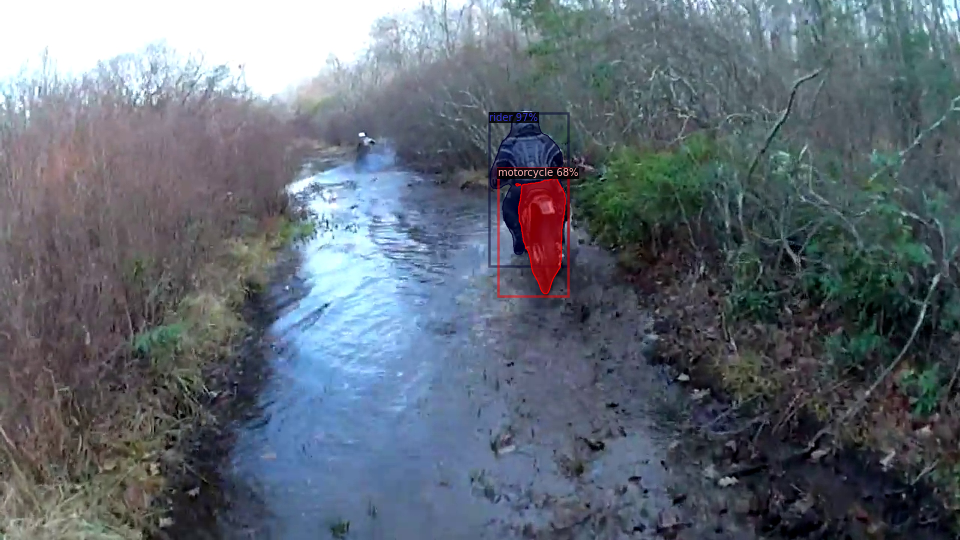

In [12]:
def print_inference(img_path, predictor):
  img = cv2.imread(img_path)
  outputs = predictor(img)
  v = Visualizer(img[:, :, ::-1], MetadataCatalog.get(cfg.DATASETS.TRAIN[0]), scale=0.5)
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])


# Esempio di utilizzo
print_inference("/content/drive/MyDrive/datasets/wd_public_02/images_test/tk0000_100000.jpg", predictor)

In [13]:
%load_ext tensorboard
%tensorboard --logdir output

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 1433), started 0:07:49 ago. (Use '!kill 1433' to kill it.)

<IPython.core.display.Javascript object>

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


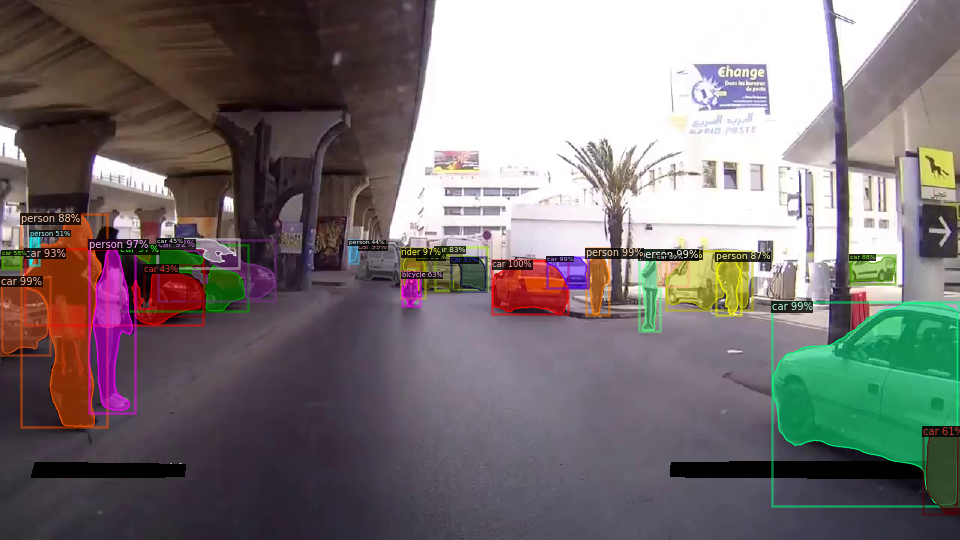

In [14]:
print_inference("/content/drive/MyDrive/datasets/wd_public_02/images_test/tn0033_100000.jpg", predictor)

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


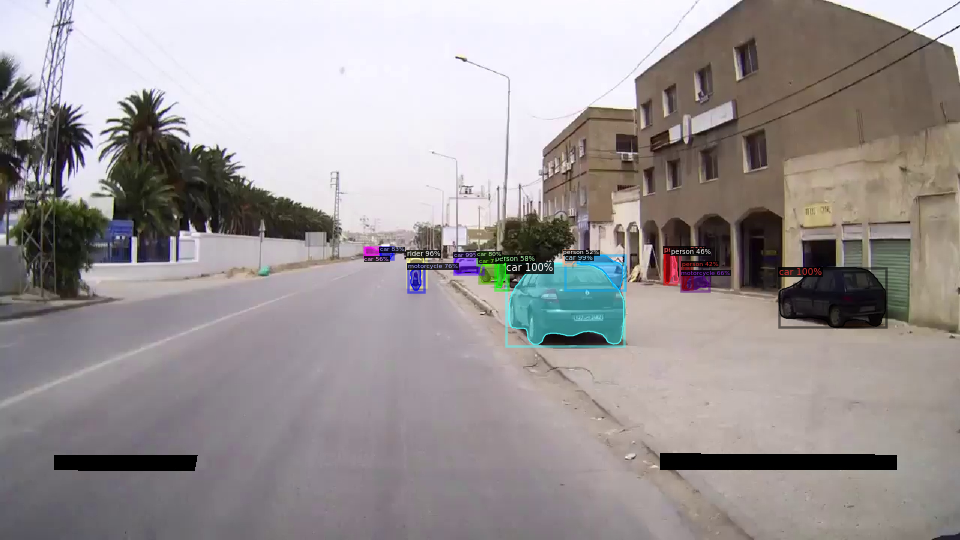

In [15]:
print_inference("/content/drive/MyDrive/datasets/wd_public_02/images_test/tn0132_100000.jpg", predictor)

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


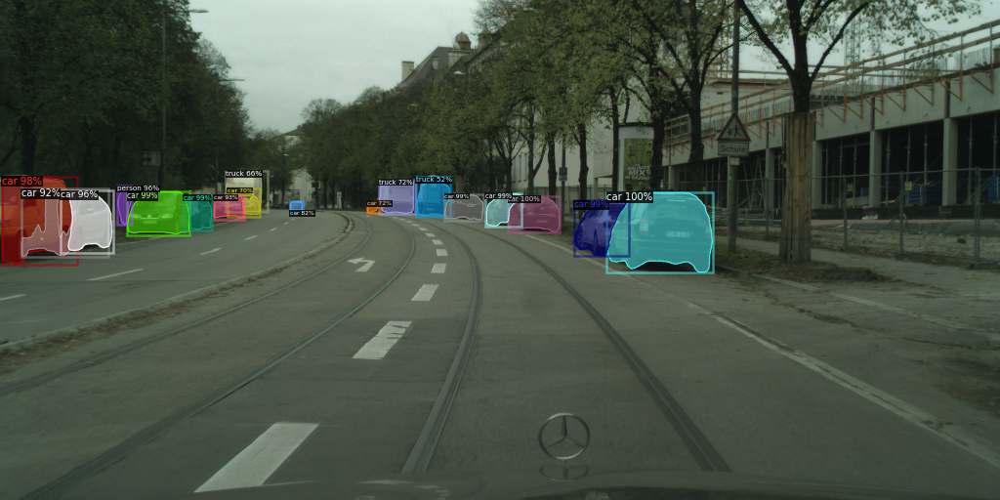

In [16]:
print_inference("/content/drive/MyDrive/datasets/cityscapes/leftImg8bit/test/munich/munich_000383_000019_leftImg8bit.png", predictor)

/usr/local/lib/python3.7/dist-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride


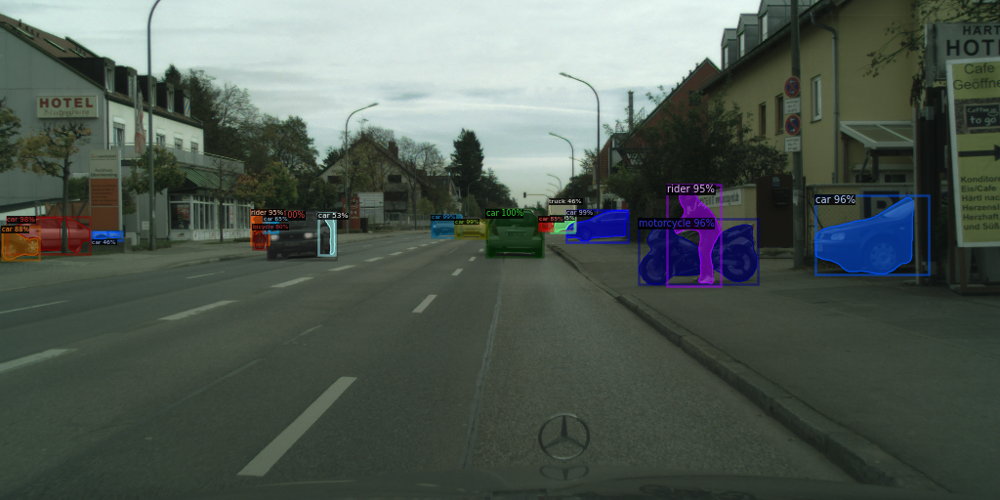

In [17]:
print_inference("/content/drive/MyDrive/datasets/cityscapes/leftImg8bit/test/munich/munich_000000_000019_leftImg8bit.png", predictor)